In [1]:
#Importar las librerías necesarias
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

In [2]:
#Directorio de archivos
directory = './'

In [3]:
# Lista para almacenardataframes
dataframes = []

In [4]:
# Leer todos los archivos .dat en el directorio
for filename in sorted(os.listdir(directory)):
    if filename.startswith('xa') and filename.endswith('.dat'):
        file_path = os.path.join(directory, filename)
        df = pd.read_csv(file_path, delim_whitespace=True, header=None)
        dataframes.append(df)

In [5]:
df

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18
0,100,36,73,199,73,6,162,40,20,127,189,401,125,72,6,19,200,204,bus
1,91,36,72,162,60,8,150,44,19,133,166,334,121,63,2,22,196,205,saab
2,91,41,64,148,61,8,129,51,18,142,161,249,153,68,6,12,194,201,van
3,86,39,58,125,55,5,117,57,17,134,140,204,148,69,7,6,190,194,van
4,95,53,95,202,65,10,193,34,22,160,220,559,237,71,3,2,188,196,saab
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
89,93,39,87,183,64,8,169,40,20,134,200,422,149,72,7,25,188,195,saab
90,89,46,84,163,66,11,159,43,20,159,173,368,176,72,1,20,186,197,van
91,106,54,101,222,67,12,222,30,25,173,228,721,200,70,3,4,187,201,saab
92,86,36,78,146,58,7,135,50,18,124,155,270,148,66,0,25,190,195,saab


In [6]:
# Concatenar todos los dataframes
df = pd.concat(dataframes, ignore_index=True)

In [8]:
# Variable para nombres a las columnas
column_names = [
    'compactness', 'circularity', 'distance_circularity', 'radius_ratio', 
    'pr.axis_aspect_ratio', 'max.length_aspect_ratio', 'scatter_ratio', 
    'elongatedness', 'pr.axis_rectangularity', 'max.length_rectangularity', 
    'scaled_variance_major', 'scaled_variance_minor', 'scaled_radius_gyration', 
    'skewness_about_major', 'skewness_about_minor', 'kurtosis_about_minor', 
    'kurtosis_about_major', 'hollows_ratio', 'class'
]
df.columns = column_names

In [9]:
df.head()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance_major,scaled_variance_minor,scaled_radius_gyration,skewness_about_major,skewness_about_minor,kurtosis_about_minor,kurtosis_about_major,hollows_ratio,class
0,95,48,83,178,72,10,162,42,20,159,176,379,184,70,6,16,187,197,van
1,91,41,84,141,57,9,149,45,19,143,170,330,158,72,9,14,189,199,van
2,104,50,106,209,66,10,207,32,23,158,223,635,220,73,14,9,188,196,saab
3,93,41,82,159,63,9,144,46,19,143,160,309,127,63,6,10,199,207,van
4,85,44,70,205,103,52,149,45,19,144,241,325,188,127,9,11,180,183,bus


In [10]:
df.tail()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance_major,scaled_variance_minor,scaled_radius_gyration,skewness_about_major,skewness_about_minor,kurtosis_about_minor,kurtosis_about_major,hollows_ratio,class
841,93,39,87,183,64,8,169,40,20,134,200,422,149,72,7,25,188,195,saab
842,89,46,84,163,66,11,159,43,20,159,173,368,176,72,1,20,186,197,van
843,106,54,101,222,67,12,222,30,25,173,228,721,200,70,3,4,187,201,saab
844,86,36,78,146,58,7,135,50,18,124,155,270,148,66,0,25,190,195,saab
845,85,36,66,123,55,5,120,56,17,128,140,212,131,73,1,18,186,190,van


### Columna objetivo Class
Columna Class esta columna es el objetivo ya que nos permite determinar o predecir el tipo de automovil dentro del dataset apartir del resto de caracteristicas, es fundamental para el problema de clasificación de tipos de vehículos, ya que define el objetivo del análisis y del modelo de clasificación. Sin la misma, no  seria posible el uso de los datos para entrenar, evaluar o interpretar un modelo de clasificación.

la columna `class` es crucial para el análisis exploratorio de datos, la selección de características y la visualización de datos, lo que nos permite entender mejor las relaciones entre las características y las clases de vehículos.


Esta columna, contiene informacion del tipo de vehiculo del problema de clasificación en este caso consta de 4 valores:
- OPEL
- SAAB
- BUS
- VAN


In [11]:
# Valores únicos.
df['class'].value_counts()

bus     218
saab    217
opel    212
van     199
Name: class, dtype: int64

In [13]:
# Examinamos si existen datos duplicados

df.duplicated().sum()

0

In [ ]:
#df=df.drop_duplicates()

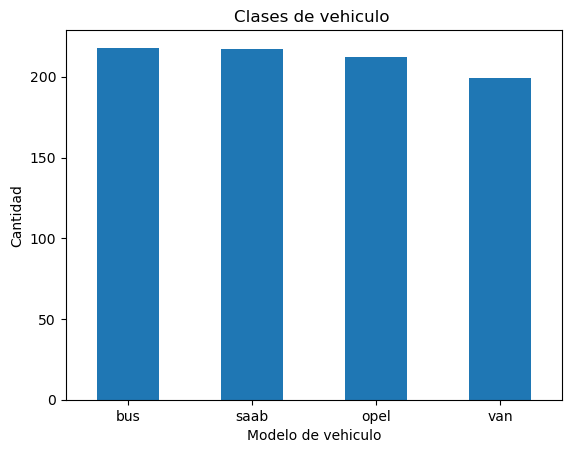

In [12]:
#Histograma de class
df['class'].value_counts().plot(kind="bar")
plt.title("Clases de vehiculo ")
plt.xlabel("Modelo de vehiculo")
plt.xticks(rotation=0)
plt.ylabel("Cantidad")
plt.show()

Observamos que los valores por cada clase de vehículo tiene valores de muestras similares, lo que permite tener una mejor consistencia en los datos y en los resultados en modelos predictivos

Asignación de valores numéricos a la columna objeto de estudio

In [14]:
# Usar factorize para convertir valores textuales a numéricos
#df['class'] = pd.factorize(df['class'])[0]

# Crear un diccionario de mapeo
mapping = {'bus': 0, 'saab': 1, 'opel': 2, 'van': 3}

# Asignar los valores utilizando map
df['class'] = df['class'].map(mapping)

In [15]:
df.head()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance_major,scaled_variance_minor,scaled_radius_gyration,skewness_about_major,skewness_about_minor,kurtosis_about_minor,kurtosis_about_major,hollows_ratio,class
0,95,48,83,178,72,10,162,42,20,159,176,379,184,70,6,16,187,197,3
1,91,41,84,141,57,9,149,45,19,143,170,330,158,72,9,14,189,199,3
2,104,50,106,209,66,10,207,32,23,158,223,635,220,73,14,9,188,196,1
3,93,41,82,159,63,9,144,46,19,143,160,309,127,63,6,10,199,207,3
4,85,44,70,205,103,52,149,45,19,144,241,325,188,127,9,11,180,183,0


In [17]:
#Tamaño del dataset
df.shape

(846, 19)

Tabla de variables estadísticas descriptivas:  media, la desviación estándar, los valores máximos y mínimos, y los cuartiles de los datos numéricos para cada columna

In [16]:
df.describe()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance_major,scaled_variance_minor,scaled_radius_gyration,skewness_about_major,skewness_about_minor,kurtosis_about_minor,kurtosis_about_major,hollows_ratio,class
count,846.000000,846.000000,846.000000,846.000000,846.000000,846.000000,846.000000,846.000000,846.000000,846.000000,846.000000,846.000000,846.00000,846.000000,846.000000,846.000000,846.000000,846.000000,846.000000
mean,93.678487,44.861702,82.088652,168.940898,61.693853,8.567376,168.839243,40.933806,20.582742,147.998818,188.625296,439.911348,174.70331,72.462175,6.377069,12.599291,188.932624,195.632388,1.463357
std,8.234474,6.169866,15.771533,33.472183,7.888251,4.601217,33.244978,7.811560,2.592138,14.515652,31.394837,176.692614,32.54649,7.486974,4.918353,8.931240,6.163949,7.438797,1.111726
min,73.000000,33.000000,40.000000,104.000000,47.000000,2.000000,112.000000,26.000000,17.000000,118.000000,130.000000,184.000000,109.00000,59.000000,0.000000,0.000000,176.000000,181.000000,0.000000
25%,87.000000,40.000000,70.000000,141.000000,57.000000,7.000000,146.250000,33.000000,19.000000,137.000000,167.000000,318.250000,149.00000,67.000000,2.000000,5.000000,184.000000,190.250000,0.000000
50%,93.000000,44.000000,80.000000,167.000000,61.000000,8.000000,157.000000,43.000000,20.000000,146.000000,178.500000,364.000000,173.00000,71.500000,6.000000,11.000000,188.000000,197.000000,1.000000
75%,100.000000,49.000000,98.000000,195.000000,65.000000,10.000000,198.000000,46.000000,23.000000,159.000000,217.000000,587.000000,198.00000,75.000000,9.000000,19.000000,193.000000,201.000000,2.000000
max,119.000000,59.000000,112.000000,333.000000,138.000000,55.000000,265.000000,61.000000,29.000000,188.000000,320.000000,1018.000000,268.00000,135.000000,22.000000,41.000000,206.000000,211.000000,3.000000


# Comprension de variables

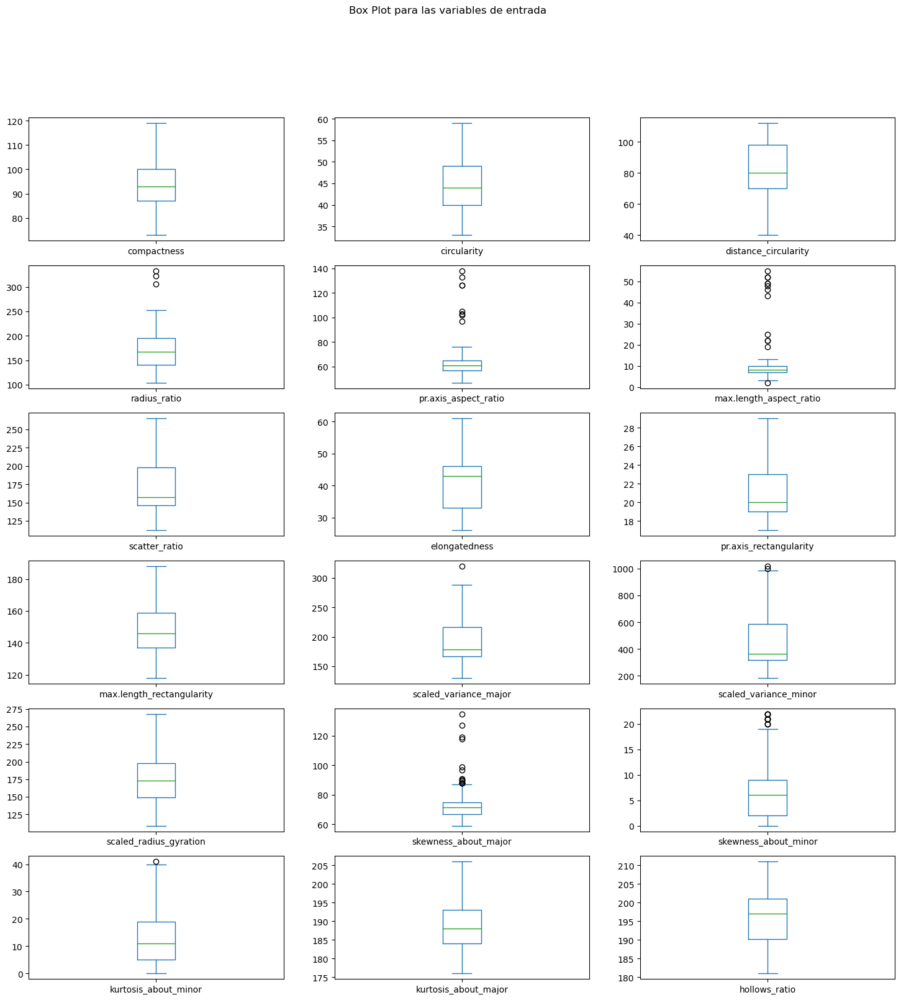

In [18]:
df.drop('class', axis=1).plot(kind='box', subplots=True, layout=(6,3), sharex=False, sharey=False, figsize=(18,18), title='Box Plot para las variables de entrada')
#plt.savefig('vino')
plt.show()

Encontramos diferentes datos atípicos dentro de cada una de las variables, estos pueden considerar un problema a la hora de clasificar los tipos de vehículo


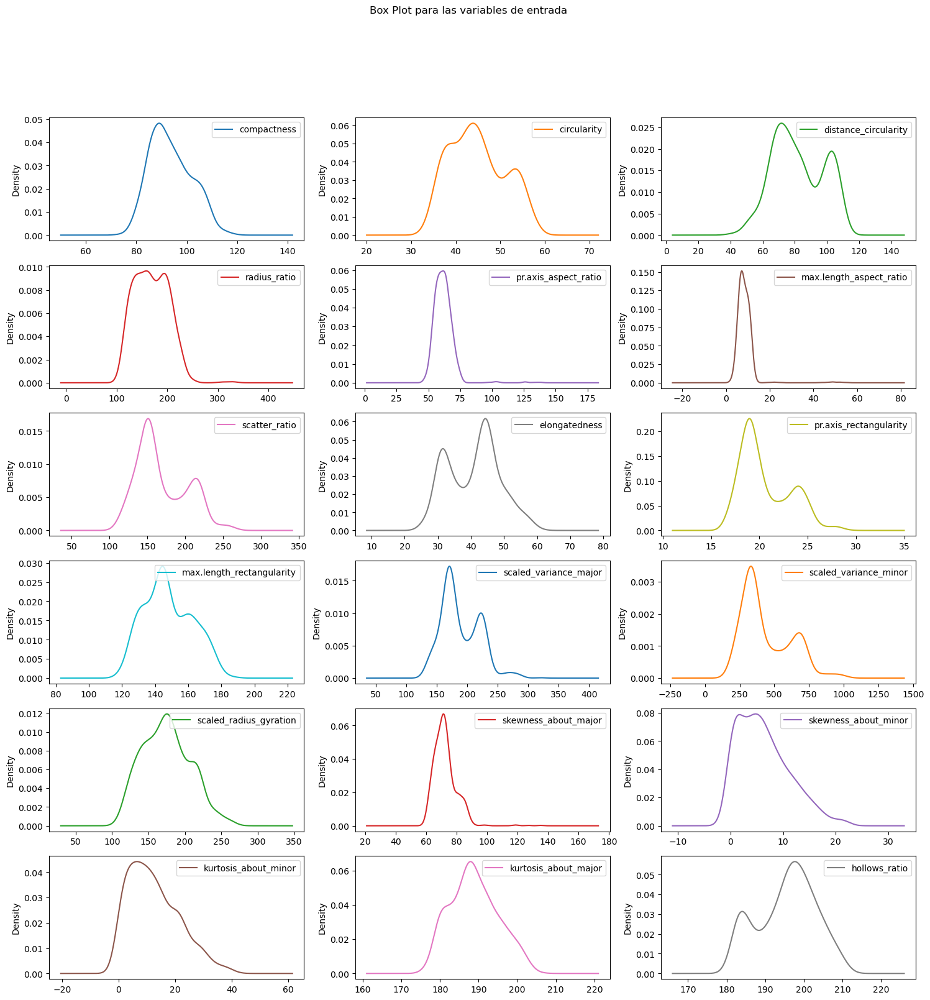

In [19]:
df.drop('class', axis=1).plot(kind='kde', subplots=True, layout=(6,3), sharex=False, sharey=False, figsize=(18,18), title='Box Plot para las variables de entrada')
plt.show()

Visualizamos las distribución de datos de cada variable por medio de  un gráfico tipo KDE 


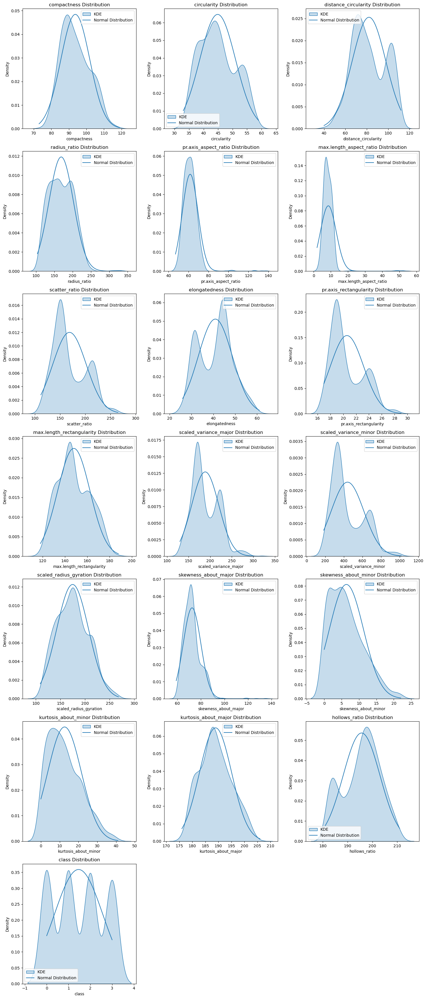

In [26]:
num_cols = len(df.columns)
num_rows = (num_cols // 3) + (1 if num_cols % 3 != 0 else 0)

# layout dinámico
fig, axes = plt.subplots(num_rows, 3, figsize=(15, 5 * num_rows))
axes = axes.flatten()

for i, col in enumerate(df.columns):
    # KDE
    sns.kdeplot(df[col], fill=True, label='KDE', ax=axes[i])
    # distribución normal teórica
    mean = df[col].mean()
    std = df[col].std()
    x = np.linspace(df[col].min(), df[col].max(), 100)
    axes[i].plot(x, norm.pdf(x, mean, std), label='Normal Distribution')
    axes[i].set_title(col + ' Distribution')
    axes[i].legend()

# Eliminar subplots vacíos
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

Comparación de gráfico kde VS distribución normal


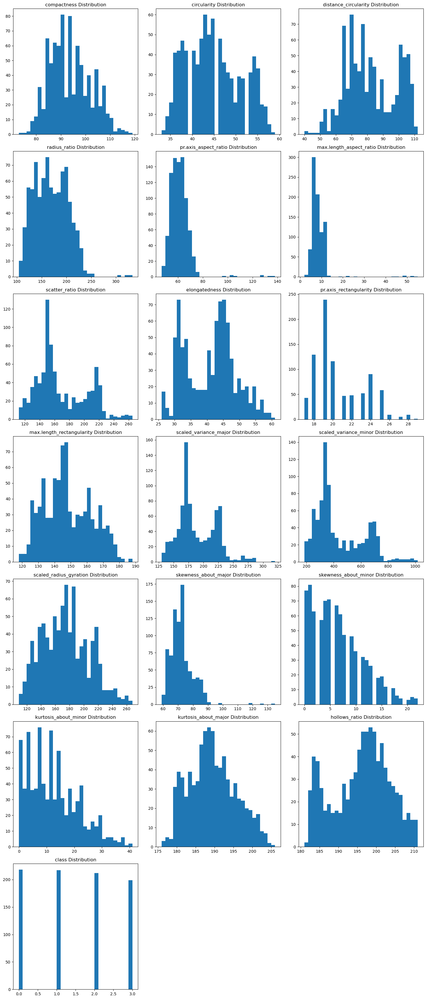

In [27]:
num_cols = len(df.columns)
num_rows = (num_cols // 3) + (1 if num_cols % 3 != 0 else 0)

fig, axes = plt.subplots(num_rows, 3, figsize=(15, 5 * num_rows))
axes = axes.flatten()

for i, col in enumerate(df.columns):
    axes[i].hist(df[col], bins=30)
    axes[i].set_title(col + ' Distribution')

for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

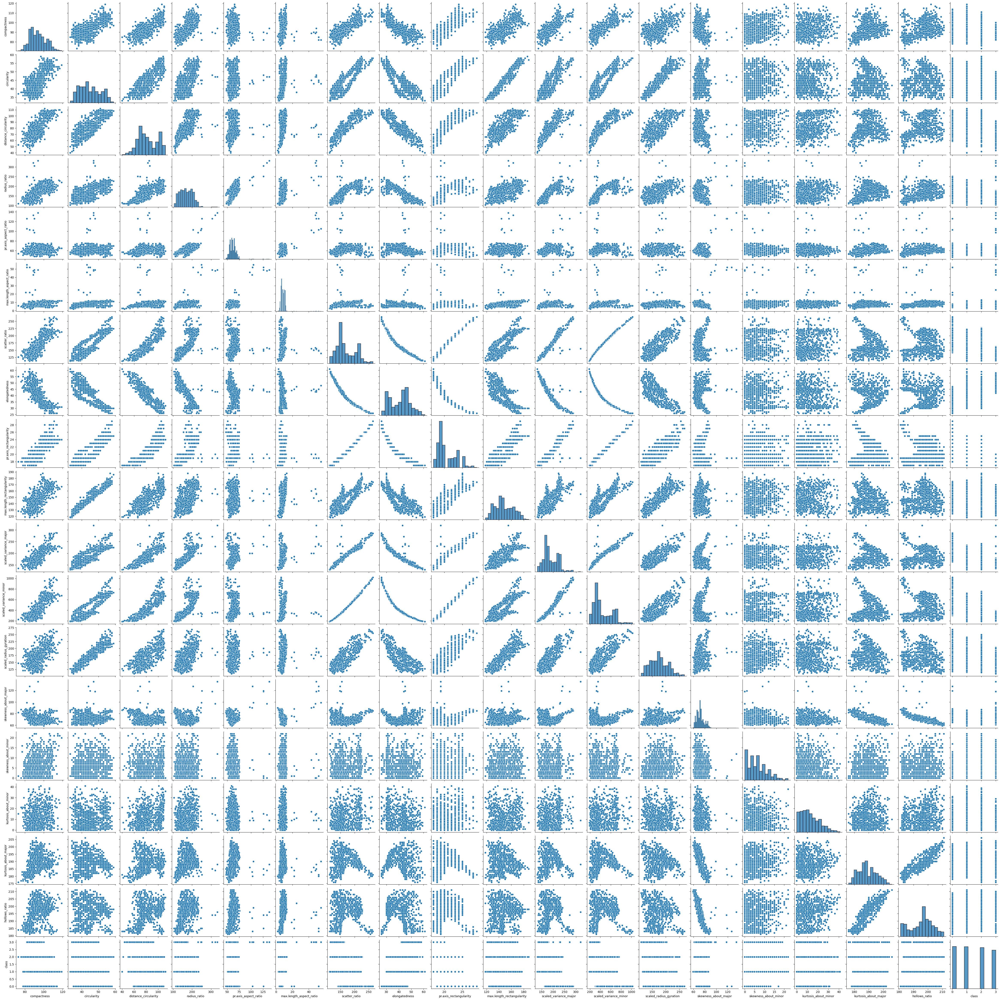

In [29]:
sns.pairplot(df)

# Relacion entre variables

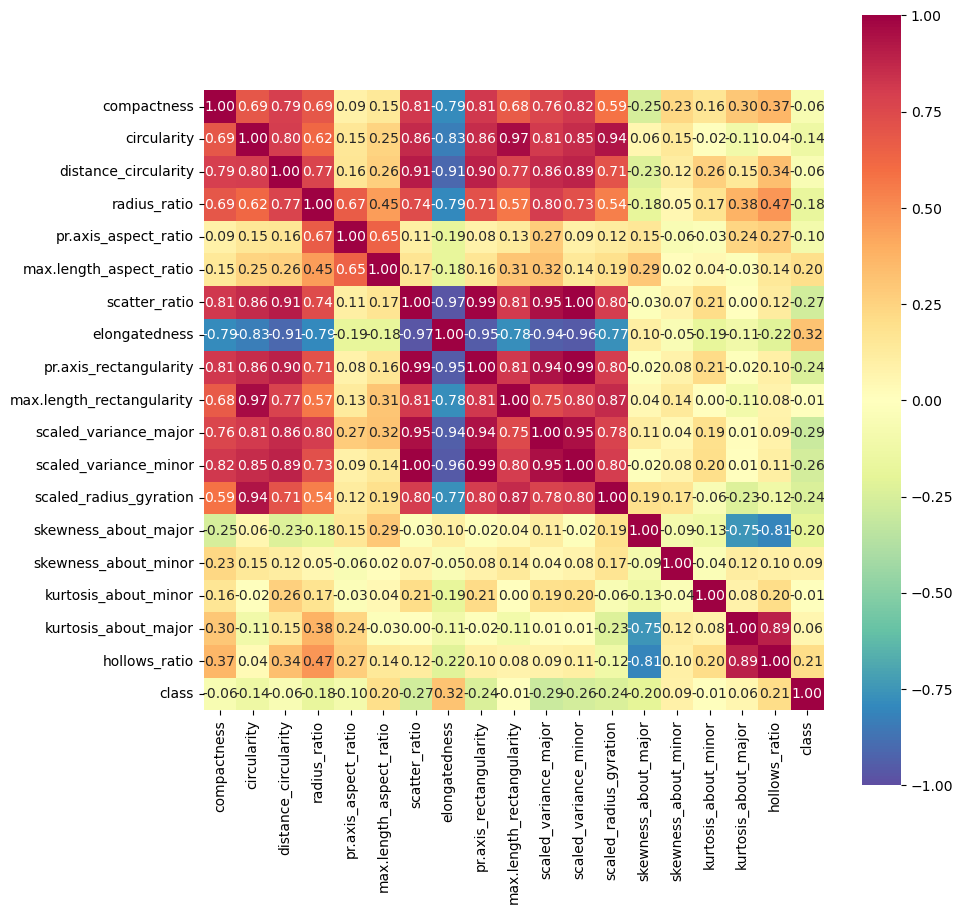

In [31]:
corrmat = df.corr()
plt.figure(figsize=(10,10))
hm = sns.heatmap(corrmat, 
                 cbar=True, 
                 annot=True, 
                 square=True,
                 vmin=-1,
                 vmax=1,
                 fmt='.2f', 
                 annot_kws={'size': 10}, 
                 yticklabels=df.columns, 
                 xticklabels=df.columns, 
                 cmap="Spectral_r")

plt.show()

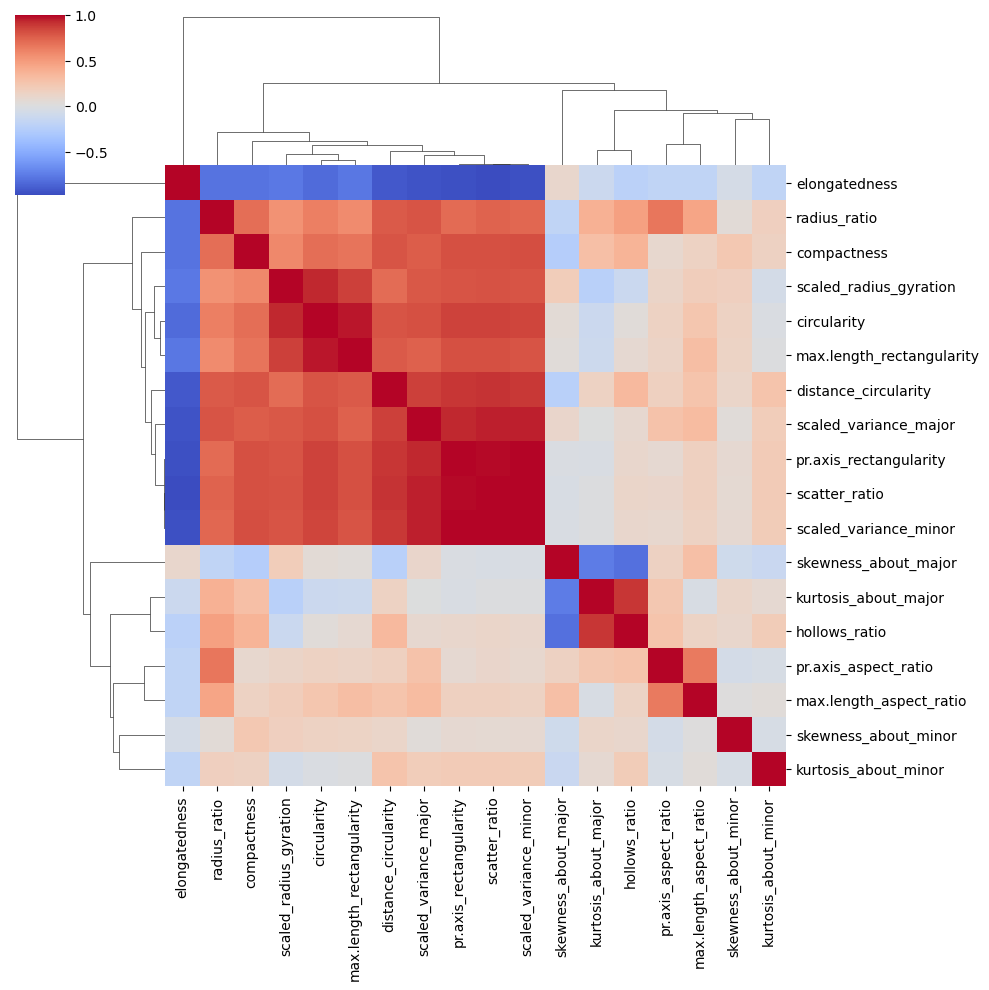

In [32]:
sns.clustermap(df.iloc[:, :18].corr(),cmap='coolwarm')

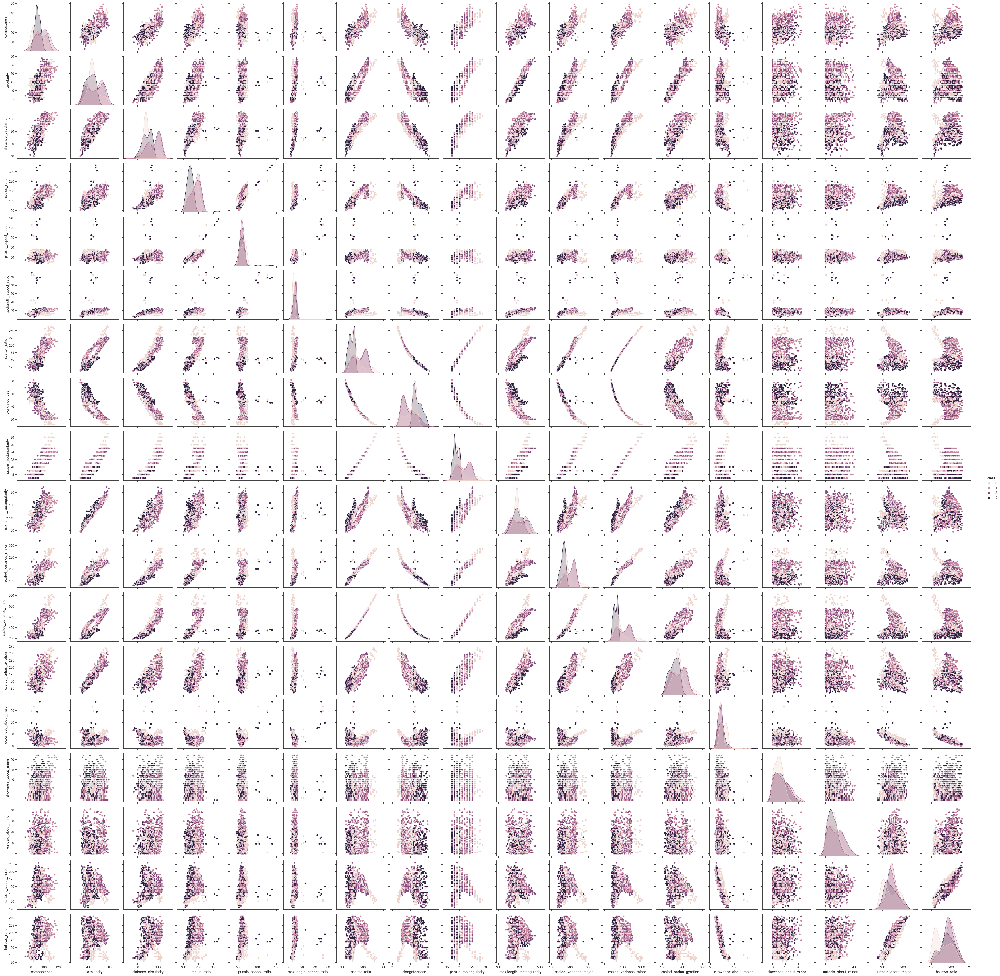

In [33]:
# Plotting scatter plot
sns.set(style="ticks")
sns.pairplot(data=df, vars=['compactness', 'circularity', 'distance_circularity', 'radius_ratio', 
    'pr.axis_aspect_ratio', 'max.length_aspect_ratio', 'scatter_ratio', 
    'elongatedness', 'pr.axis_rectangularity', 'max.length_rectangularity', 
    'scaled_variance_major', 'scaled_variance_minor', 'scaled_radius_gyration', 
    'skewness_about_major', 'skewness_about_minor', 'kurtosis_about_minor', 
    'kurtosis_about_major', 'hollows_ratio'], hue='class', diag_kind="kde")
plt.show()

Al analizar de forma visual las variables en los mapas de calor, encontramos comportamientos especiales  en las variables
scatter_ratio, pr.axis_rectangularity, max.length_rectangularity, scaled_variance_major, scaled_variance_minor, scaled_radius_gyration, por lo tanto analizamos la relación existente con class


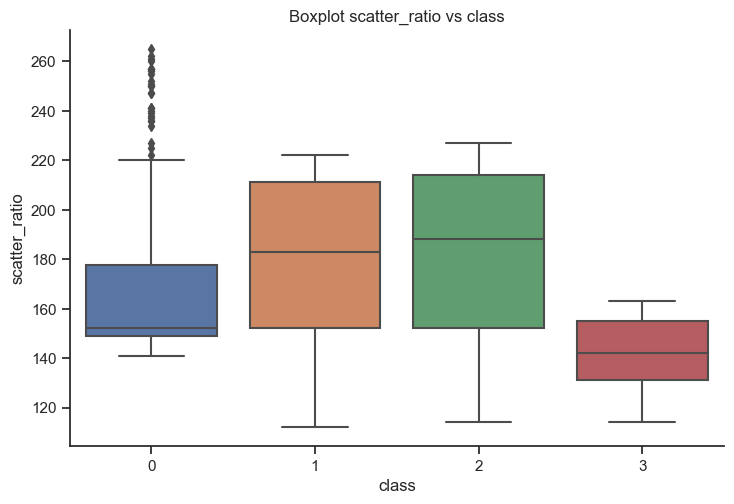

In [34]:
sns.catplot(x="class", y="scatter_ratio", data=df, kind="box", aspect=1.5)
plt.title("Boxplot scatter_ratio vs class")
plt.show()

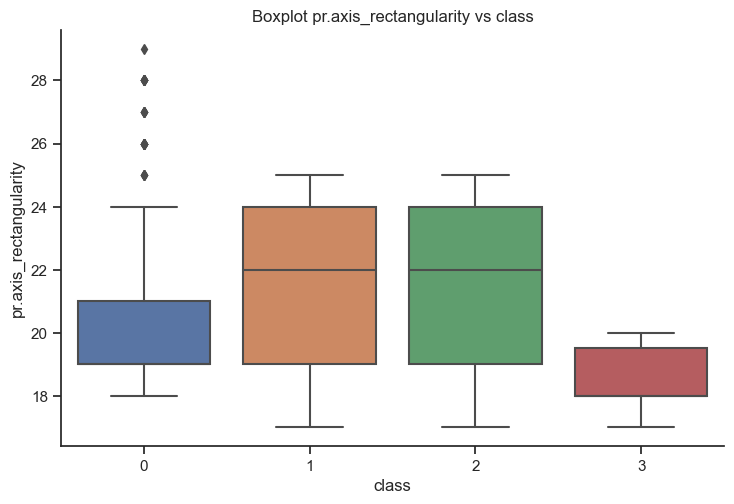

In [35]:
sns.catplot(x="class", y="pr.axis_rectangularity", data=df, kind="box", aspect=1.5)
plt.title("Boxplot pr.axis_rectangularity vs class")
plt.show()

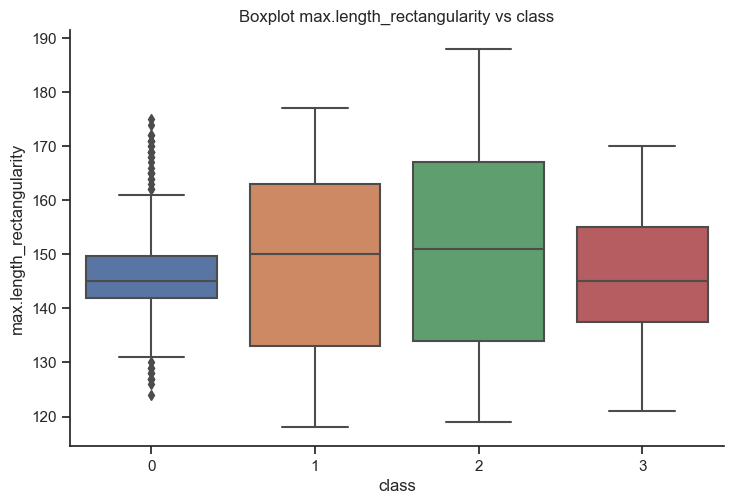

In [36]:
sns.catplot(x="class", y="max.length_rectangularity", data=df, kind="box", aspect=1.5)
plt.title("Boxplot max.length_rectangularity vs class")
plt.show()

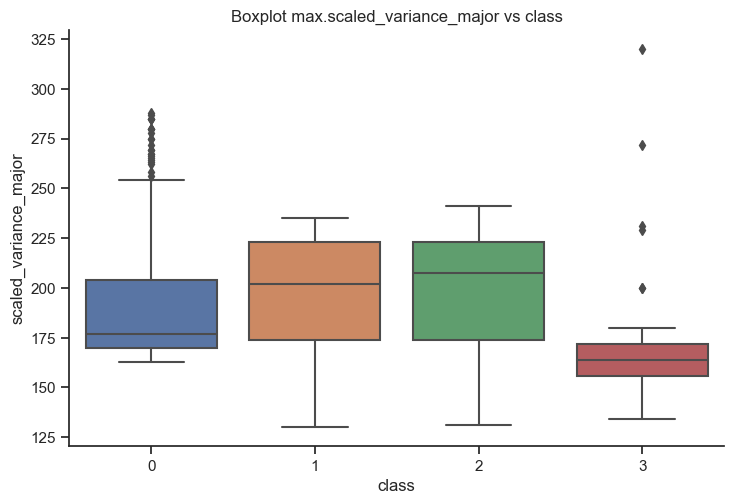

In [38]:
sns.catplot(x="class", y="scaled_variance_major", data=df, kind="box", aspect=1.5)
plt.title("Boxplot max.scaled_variance_major vs class")
plt.show()

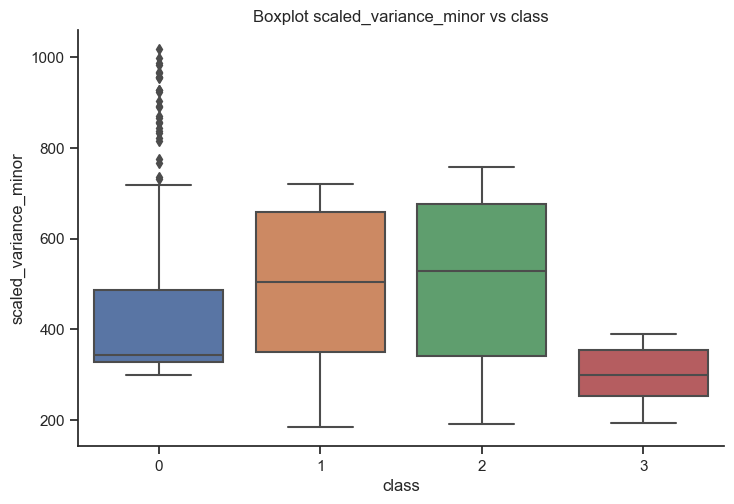

In [39]:
 
sns.catplot(x="class", y="scaled_variance_minor", data=df, kind="box", aspect=1.5)
plt.title("Boxplot scaled_variance_minor vs class")
plt.show()

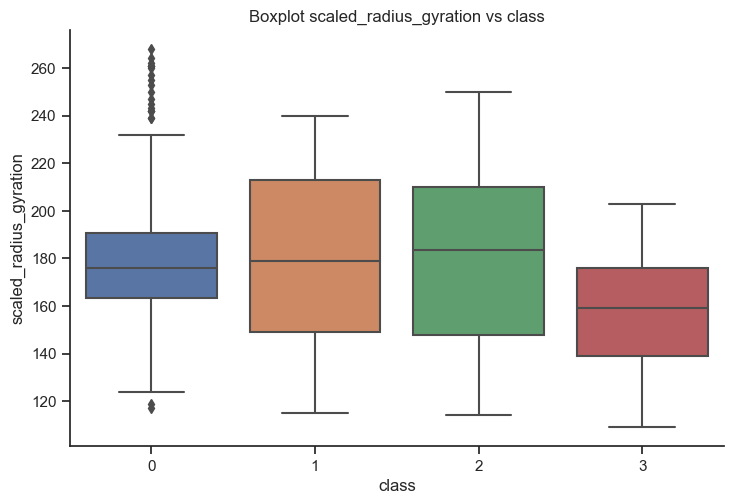

In [40]:
sns.catplot(x="class", y="scaled_radius_gyration", data=df, kind="box", aspect=1.5)
plt.title("Boxplot scaled_radius_gyration vs class")
plt.show()

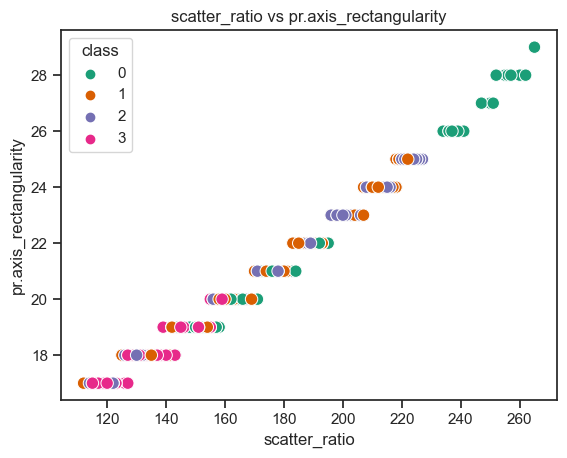

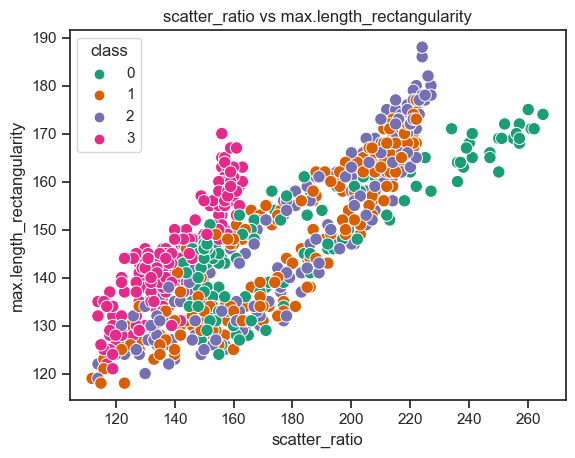

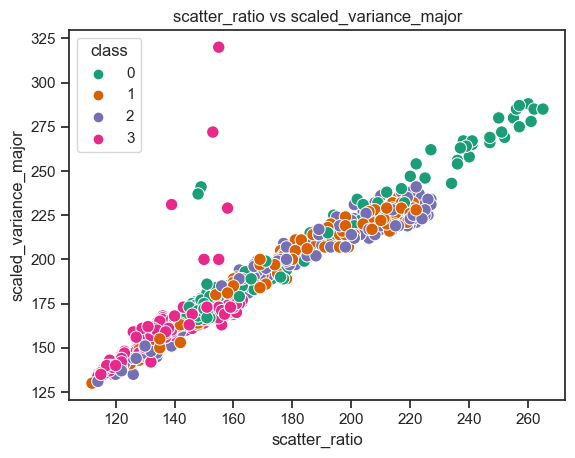

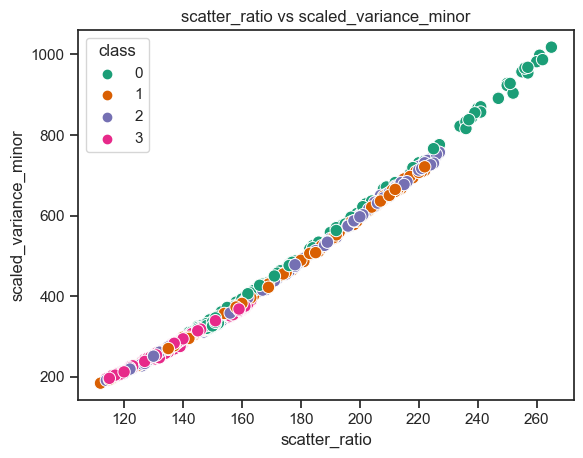

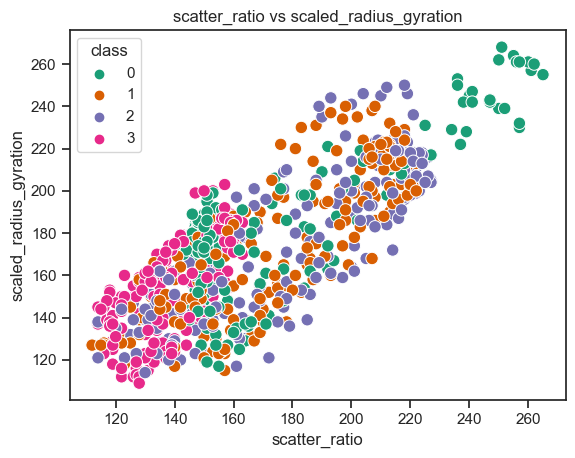

...

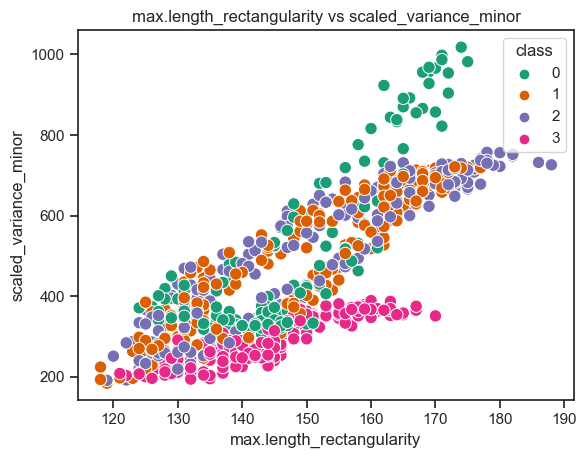

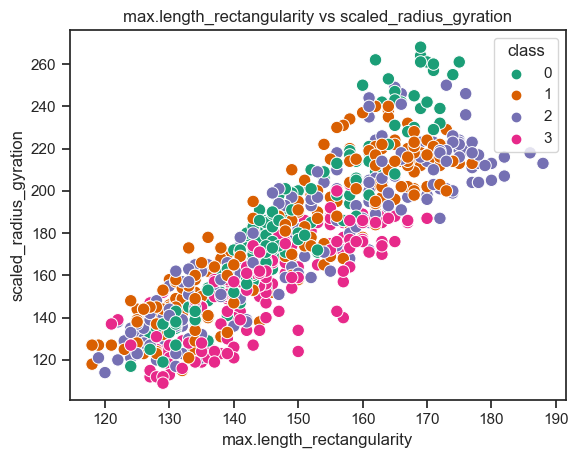

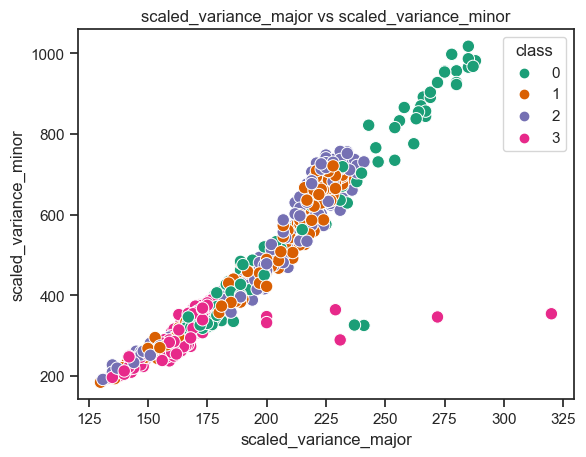

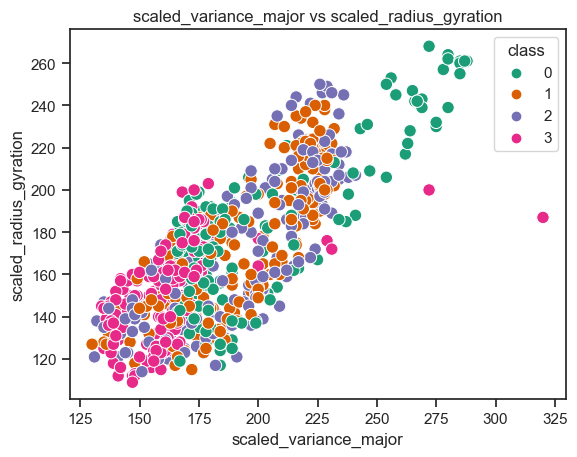

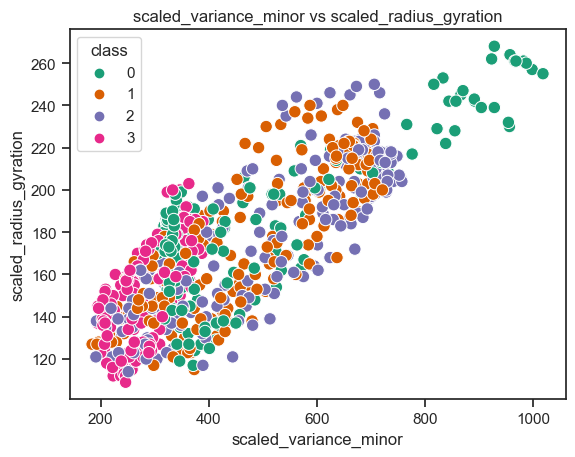

In [41]:
# Lista de variables que quieres graficar
variables = ["scatter_ratio", "pr.axis_rectangularity", "max.length_rectangularity", 
             "scaled_variance_major", "scaled_variance_minor", "scaled_radius_gyration"]

# Crear gráficos de dispersión
for i in range(len(variables)):
    for j in range(i + 1, len(variables)):
        plt.figure()
        sns.scatterplot(x=variables[i], y=variables[j], hue="class", data=df, palette="Dark2", s=80)
        plt.title(f'{variables[i]} vs {variables[j]}')
        plt.show()

# Conclusión: 

Podemos observar que las variables , presentan una alta correlación con la variable objeto de estudio class, esta correlación positiva influye directamente en la clasificación de los tipos de vehículos, por ejemplo valores de variables elevados en variables pr.axis_rentangular y scatter_ratio muestran tendencia a clases de vehículos tipo  bus, mientras que valores bajos muestran una tendencia a vehículos tipo van, y valores de centrales muestran una tendencia para clases de tipo saab y opel.

Muchas de las variables tienen distribuciones sesgadas a la derecha, lo que indica la presencia de valores extremos altos. Las medidas de tendencia central y dispersión proporcionan una visión clara de la variabilidad y la centralidad de cada variable. 

además podemos encontrar dentro del conjunto de datos, algunos tipos de datos atípicos en las variables pr.axis_aspect_ratio, 
max.length_aspect_ratio, skewness_about_major, esots datos atipicos pueden afectar en cierta medida las capacidades de clasificación de un modelo, ya que pueden alterar de alguna forma los valores promedio de los datos

Con respecto a los datos, podemos decir que estos son bastante equilibrados y que permiten analizar de forma correcta cada uno de los tipos de clases de vehículos




In [ ]:
# Crear un diccionario de mapeo
mapping = {'bus': 0, 'saab': 1, 'opel': 2, 'van': 3}

In [ ]:
repo: https://archive.ics.uci.edu/dataset/149/statlog+vehicle+silhouettes